In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.feature_selection import VarianceThreshold
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.ensemble import RandomForestClassifier

In [2]:
pd.set_option("display.max_columns", None)

Load data

In [3]:
df_merged = pd.read_csv('../data/merged_df.csv')
df_merged

,event_date,event_name,fighter_blue,fighter_red,weight_class,win_method,winner,octagon_debut_blue,age_blue,height_blue,weight_blue,reach_blue,leg_reach_blue,wins_blue,losses_blue,draws_blue,wins_by_knockout_blue,first_round_finishes_blue,win_by_dec_blue,win_by_sub_blue,sig_strikes_landed_blue,sig_strikes_attempted_blue,takedowns_landed_blue,takedowns_attempted_blue,sig_strikes_landed_per_minute_blue,sig_strikes_absorbed_per_minute_blue,takedowns_avg_blue,submission_avg_blue,sig_strikes_defense_blue,takedown_defense_blue,knockdown_avg_blue,fight_time_avg_blue,sig_strikes_standing_blue,sig_strikes_clinch_blue,sig_strikes_ground_blue,head_target_blue,body_target_blue,leg_target_blue,octagon_debut_red,age_red,height_red,weight_red,reach_red,leg_reach_red,wins_red,losses_red,draws_red,wins_by_knockout_red,first_round_finishes_red,win_by_dec_red,win_by_sub_red,sig_strikes_landed_red,sig_strikes_attempted_red,takedowns_landed_red,takedowns_attempted_red,sig_strikes_landed_per_minute_red,sig_strikes_absorbed_per_minute_red,takedowns_avg_red,submission_avg_red,sig_strikes_defense_red,takedown_defense_red,knockdown_avg_red,fight_time_avg_red,sig_strikes_standing_red,sig_strikes_clinch_red,sig_strikes_ground_red,head_target_red,body_target_red,leg_target_red
0,2007-04-05,UFC Fight Night: Stevenson vs Guillard,Naoyuki Kotani,Thiago Tavares,Lightweight,Decision - Unanimous,Thiago Tavares,2007-04-05,37,68.0,156.0,72.1,39.8,33,13,7,0,0,3,25,55,177,0,18,1,3,0.83,0.83,50.0,47.0,0.00,09:00,40,4,11,30,4,21,2007-04-05,38,67.0,146.0,68.0,39.0,24,7,1,0,0,0,0,329,820,0,98,2,2,3.83,1.46,63.0,63.0,0.00,09:08,209,30,90,229,76,24
1,2007-04-21,UFC 70: Nations Collide,Dennis Siver,Jess Liaudin,Welterweight,Submission,Jess Liaudin,2007-04-21,44,65.0,146.0,70.0,38.0,23,11,0,0,0,0,0,869,2678,13,40,4,3,0.87,0.33,65.0,65.0,0.47,10:41,737,46,86,494,118,257,2007-04-21,32,69.0,155.0,71.3,39.2,12,11,0,0,0,0,0,90,175,0,15,2,3,3.28,1.64,42.0,31.0,0.82,07:19,40,35,15,70,9,11
2,2007-04-21,UFC 70: Nations Collide,Matt Grice,Terry Etim,Lightweight,Submission,Terry Etim,2007-04-21,41,68.0,145.0,70.0,37.9,15,5,0,0,0,0,0,252,472,0,24,4,3,2.19,0.49,56.0,82.0,0.73,08:48,68,59,125,196,33,23,2007-04-21,37,73.0,155.0,73.0,39.7,15,5,0,0,0,0,0,229,639,0,10,2,3,0.43,1.42,67.0,39.0,0.28,09:37,199,27,3,110,25,94
3,2007-06-12,UFC Fight Night: Stout vs Fisher,Jason Black,Thiago Tavares,Lightweight,Submission,Thiago Tavares,2007-06-12,50,68.0,156.0,72.9,40.8,22,4,1,0,0,0,0,33,69,0,3,1,3,0.48,6.25,45.0,29.0,0.00,09:22,9,7,17,27,6,0,2007-04-05,38,67.0,146.0,68.0,39.0,24,7,1,0,0,0,0,329,820,0,98,2,2,3.83,1.46,63.0,63.0,0.00,09:08,209,30,90,229,76,24
4,2007-06-12,UFC Fight Night: Stout vs Fisher,Chad Reiner,Anthony Johnson,Welterweight,KO/TKO,Anthony Johnson,2007-01-25,41,71.0,171.0,72.4,40.2,13,2,0,0,0,0,0,8,39,0,3,1,2,0.99,1.97,46.0,25.0,0.00,07:37,5,3,0,4,2,2,2007-06-12,39,74.0,203.8,78.0,44.0,22,6,0,0,0,0,0,381,800,0,33,3,2,2.43,0.64,60.0,77.0,1.66,06:10,214,67,100,255,57,69
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5864,2025-08-23,UFC Fight Night: Walker vs. Zhang,Kevin Borjas,Sumudaerji,Flyweight,Decision - Unanimous,Sumudaerji,2023-11-11,27,65.0,125.0,68.0,36.0,10,4,0,8,5,2,0,263,588,0,5,5,6,0.00,0.00,51.0,65.0,0.29,12:54,253,6,4,214,30,19,2025-08-24,29,68.0,126.0,72.0,38.5,18,7,0,13,11,4,1,358,698,0,4,4,3,0.18,0.74,60.0,68.0,0.37,10:10,279,29,50,227,44,87
5865,2025-08-23,UFC Fight Night: Walker vs. Zhang,Aljamain Sterling,Brian Ortega,Catch Weight,Decision - Unanimous,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.00,13:22,816,187,234,601,410,226,2014-07-26,34,68.0,146.0,69.0,39.0,16,5,0,3,4,5,8,687,1813,1,46,4,7,1.07,1.07,50.0,56.0,0.45,12:57,603,49,35,498,116,73
5866,2025-08-23,UFC 

In [4]:
df_merged.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5869 entries, 0 to 5868
Data columns (total 69 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   event_date                            5869 non-null   object 
 1   event_name                            5869 non-null   object 
 2   fighter_blue                          5869 non-null   object 
 3   fighter_red                           5869 non-null   object 
 4   weight_class                          5869 non-null   object 
 5   win_method                            5869 non-null   object 
 6   winner                                5759 non-null   object 
 7   octagon_debut_blue                    5869 non-null   object 
 8   age_blue                              5869 non-null   int64  
 9   height_blue                           5869 non-null   float64
 10  weight_blue                           5869 non-null   float64
 11  reach_blue       

Convert dates to datetime

In [5]:
df_merged['event_date'] = pd.to_datetime(df_merged['event_date'], errors='coerce')
df_merged['octagon_debut_blue'] = pd.to_datetime(df_merged['octagon_debut_blue'], errors='coerce')
df_merged['octagon_debut_red'] = pd.to_datetime(df_merged['octagon_debut_red'], errors='coerce')

In [7]:
df_merged.sort_values(by=['event_date'], inplace=True)
df_merged.reset_index(drop=True, inplace=True)

Convert fight time average column to seconds

In [8]:
df_merged['fight_time_avg_blue'] = pd.to_timedelta(df_merged['fight_time_avg_blue'] + ':00').dt.total_seconds()
df_merged['fight_time_avg_red'] = pd.to_timedelta(df_merged['fight_time_avg_red'] + ':00').dt.total_seconds()

Create new feautures

Win ratio

In [9]:
denominator_blue = df_merged['wins_blue'] + df_merged['losses_blue'] + df_merged['draws_blue']
df_merged['win_ratio_blue'] = np.where(denominator_blue != 0, df_merged['wins_blue'] / denominator_blue, 0)

denominator_red = df_merged['wins_red'] + df_merged['losses_red'] + df_merged['draws_red']
df_merged['win_ratio_red'] = np.where(denominator_red != 0, df_merged['wins_red'] / denominator_red, 0)

Days since debut

In [10]:
df_merged['days_since_debut_blue'] = (pd.Timestamp.now() - df_merged['octagon_debut_blue']).dt.days
df_merged['days_since_debut_red'] = (pd.Timestamp.now() - df_merged['octagon_debut_red']).dt.days

Days since last win

In [11]:
last_win = {}  # Dictionary to track last win date
red_last_win_days = []
blue_last_win_days = []

# Iterate over each fight
for _, row in df_merged.iterrows():
    event_date = row['event_date']
    red = row['fighter_red']
    blue = row['fighter_blue']
    winner = row['winner']

    # Compute days since last win
    red_days = (event_date - last_win.get(red)).days if red in last_win else None
    blue_days = (event_date - last_win.get(blue)).days if blue in last_win else None

    red_last_win_days.append(red_days)
    blue_last_win_days.append(blue_days)

    # Update last win date for the winner
    last_win[winner] = event_date

df_merged['days_since_win_red'] = red_last_win_days
df_merged['days_since_win_blue'] = blue_last_win_days

Days since last fight

In [12]:
last_fight_date = {}
red_days_since_fight = []
blue_days_since_fight = []

# Iterate over each fight
for _, row in df_merged.iterrows():
    event_date = row['event_date']
    red = row['fighter_red']
    blue = row['fighter_blue']

    # Compute days since last fight
    red_last = last_fight_date.get(red)
    blue_last = last_fight_date.get(blue)

    red_days = (event_date - red_last).days if red_last else None
    blue_days = (event_date - blue_last).days if blue_last else None

    red_days_since_fight.append(red_days)
    blue_days_since_fight.append(blue_days)

    # Update fight date for both fighters
    last_fight_date[red] = event_date
    last_fight_date[blue] = event_date

# Add to DataFrame
df_merged['days_since_last_fight_red'] = red_days_since_fight
df_merged['days_since_last_fight_blue'] = blue_days_since_fight

Fights in last calendar year

In [13]:
# Melt fighter_blue and fighter_red into a single fighter-event table 
df_blue = df_merged[['event_date', 'fighter_blue']].rename(columns={'fighter_blue': 'fighter'}) 
df_red = df_merged[['event_date', 'fighter_red']].rename(columns={'fighter_red': 'fighter'}) 
df_fights = pd.concat([df_blue, df_red], ignore_index=True) 

# Sort by fighter and date 
df_fights = df_fights.sort_values(by=['fighter', 'event_date']) 

# For each fighter, count past fights in last 365 days 
def count_recent_fights(group, fighter_name):
    dates = group['event_date']
    counts = []
    for i in range(len(dates)):
        cutoff = dates.iloc[i] - pd.Timedelta(days=365)
        count = dates[(dates < dates.iloc[i]) & (dates >= cutoff)].count()
        counts.append(count)
    group = group.assign(
        fighter=fighter_name,
        fight_count_last_365_days=counts
    )
    return group

df_fights = (
    df_fights.groupby('fighter', group_keys=False)
    .apply(lambda g: count_recent_fights(g, g.name), include_groups=False)
)

# Merge for fighter_blue 
df_merged = df_merged.merge( 
    df_fights.rename(columns={ 'fighter': 'fighter_blue', 
        'fight_count_last_365_days': 'fight_count_last_365_days_blue' }), 
        on=['fighter_blue', 'event_date'], 
        how='left') 

# Merge for fighter_red 
df_merged = df_merged.merge( 
    df_fights.rename(columns={ 'fighter': 'fighter_red', 
        'fight_count_last_365_days': 'fight_count_last_365_days_red' }), 
        on=['fighter_red', 'event_date'], 
        how='left' )



Win streak

In [14]:
win_streaks = {} 
red_win_streak = []
blue_win_streak = []

# Loop through fights
for _, row in df_merged.iterrows():
    red = row['fighter_red']
    blue = row['fighter_blue']
    winner = row['winner']

    # Get current streaks (default to 0 if first time)
    red_streak = win_streaks.get(red, 0)
    blue_streak = win_streaks.get(blue, 0)

    # Append current streaks before this fight
    red_win_streak.append(red_streak)
    blue_win_streak.append(blue_streak)

    # Update win streaks
    if winner == red:
        win_streaks[red] = red_streak + 1
        win_streaks[blue] = 0  # blue lost
    elif winner == blue:
        win_streaks[blue] = blue_streak + 1
        win_streaks[red] = 0  # red lost
    else:
        # In case of draw or no result
        win_streaks[red] = 0
        win_streaks[blue] = 0

# Add new columns
df_merged['win_streak_red'] = red_win_streak
df_merged['win_streak_blue'] = blue_win_streak

In [15]:
df_merged

,event_date,event_name,fighter_blue,fighter_red,weight_class,win_method,winner,octagon_debut_blue,age_blue,height_blue,weight_blue,reach_blue,leg_reach_blue,wins_blue,losses_blue,draws_blue,wins_by_knockout_blue,first_round_finishes_blue,win_by_dec_blue,win_by_sub_blue,sig_strikes_landed_blue,sig_strikes_attempted_blue,takedowns_landed_blue,takedowns_attempted_blue,sig_strikes_landed_per_minute_blue,sig_strikes_absorbed_per_minute_blue,takedowns_avg_blue,submission_avg_blue,sig_strikes_defense_blue,takedown_defense_blue,knockdown_avg_blue,fight_time_avg_blue,sig_strikes_standing_blue,sig_strikes_clinch_blue,sig_strikes_ground_blue,head_target_blue,body_target_blue,leg_target_blue,octagon_debut_red,age_red,height_red,weight_red,reach_red,leg_reach_red,wins_red,losses_red,draws_red,wins_by_knockout_red,first_round_finishes_red,win_by_dec_red,win_by_sub_red,sig_strikes_landed_red,sig_strikes_attempted_red,takedowns_landed_red,takedowns_attempted_red,sig_strikes_landed_per_minute_red,sig_strikes_absorbed_per_minute_red,takedowns_avg_red,submission_avg_red,sig_strikes_defense_red,takedown_defense_red,knockdown_avg_red,fight_time_avg_red,sig_strikes_standing_red,sig_strikes_clinch_red,sig_strikes_ground_red,head_target_red,body_target_red,leg_target_red,win_ratio_blue,win_ratio_red,days_since_debut_blue,days_since_debut_red,days_since_win_red,days_since_win_blue,days_since_last_fight_red,days_since_last_fight_blue,fight_count_last_365_days_blue,fight_count_last_365_days_red,win_streak_red,win_streak_blue
0,2007-04-05,UFC Fight Night: Stevenson vs Guillard,Naoyuki Kotani,Thiago Tavares,Lightweight,Decision - Unanimous,Thiago Tavares,2007-04-05,37,68.0,156.0,72.1,39.8,33,13,7,0,0,3,25,55,177,0,18,1,3,0.83,0.83,50.0,47.0,0.00,32400.0,40,4,11,30,4,21,2007-04-05,38,67.0,146.0,68.0,39.0,24,7,1,0,0,0,0,329,820,0,98,2,2,3.83,1.46,63.0,63.0,0.00,32880.0,209,30,90,229,76,24,0.622642,0.750000,6717,6717,NaN,NaN,NaN,NaN,0,0,0,0
1,2007-04-21,UFC 70: Nations Collide,Dennis Siver,Jess Liaudin,Welterweight,Submission,Jess Liaudin,2007-04-21,44,65.0,146.0,70.0,38.0,23,11,0,0,0,0,0,869,2678,13,40,4,3,0.87,0.33,65.0,65.0,0.47,38460.0,737,46,86,494,118,257,2007-04-21,32,69.0,155.0,71.3,39.2,12,11,0,0,0,0,0,90,175,0,15,2,3,3.28,1.64,42.0,31.0,0.82,26340.0,40,35,15,70,9,11,0.676471,0.521739,6701,6701,NaN,NaN,NaN,NaN,0,0,0,0
2,2007-04-21,UFC 70: Nations Collide,Matt Grice,Terry Etim,Lightweight,Submission,Terry Etim,2007-04-21,41,68.0,145.0,70.0,37.9,15,5,0,0,0,0,0,252,472,0,24,4,3,2.19,0.49,56.0,82.0,0.73,31680.0,68,59,125,196,33,23,2007-04-21,37,73.0,155.0,73.0,39.7,15,5,0,0,0,0,0,229,639,0,10,2,3,0.43,1.42,67.0,39.0,0.28,34620.0,199,27,3,110,25,94,0.750000,0.750000,6701,6701,NaN,NaN,NaN,NaN,0,0,0,0
3,2007-06-12,UFC Fight Night: Stout vs Fisher,Jason Black,Thiago Tavares,Lightweight,Submission,Thiago Tavares,2007-06-12,50,68.0,156.0,72.9,40.8,22,4,1,0,0,0,0,33,69,0,3,1,3,0.48,6.25,45.0,29.0,0.00,33720.0,9,7,17,27,6,0,2007-04-05,38,67.0,146.0,68.0,39.0,24,7,1,0,0,0,0,329,820,0,98,2,2,3.83,1.46,63.0,63.0,0.00,32880.0,209,30,90,229,76,24,0.814815,0.750000,6649,6717,68.0,NaN,68.0,NaN,0,1,1,0
4,2007-06-12,UFC Fight Night: Stout vs Fisher,Chad Reiner,Anthony Johnson,Welterweight,KO/TKO,Anthony Johnson,2007-01-25,41,71.0,171.0,72.4,40.2,13,2,0,0,0,0,0,8,39,0,3,1,2,0.99,1.97,46.0,25.0,0.00,27420.0,5,3,0,4,2,2,2007-06-12,39,74.0,203.8,78.0,44.0,22,6,0,0,0,0,0,381,800,0,33,3,2,2.43,0.64,60.0,77.0,1.66,22200.0,214,67,100,255,57,69,0.866667,0.785714,6787,6649,NaN,NaN,NaN,NaN,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5864,2025-08-23,UFC Fight Night: Walker vs. Zhang,Gauge Young,Maheshate,Lightweight,Decision - Unanimous,Gauge Young,2025-04-26,25,69.0,156.0,70.0,38.0,10,3,0,6,5,2

Fill null values from our new columns with 0, since these fighters usually debut and do not have stats

In [16]:
df_merged.fillna(0, inplace=True)

Perform EMA(Exponential Moving Average)

EMAt=α⋅xt+(1−α)⋅EMAt−1

In [17]:
def create_ema_features(df, fighter_cols=("fighter_blue", "fighter_red"), span=None, alpha=None):
    """
    Creates EMA features for numerical columns in a UFC fight dataset.
    
    Args:
        df (pd.DataFrame): Input dataframe with fight stats.
        fighter_cols (tuple): Columns identifying fighters (default: blue/red).
        span (int): EMA span (optional).
        alpha (float): Smoothing factor (optional, between 0 and 1).
    
    Returns:
        pd.DataFrame: A new dataframe with EMA features added.
    """
    df = df.copy()
    numeric_cols = df.select_dtypes(include="number").columns

    for corner in ["blue", "red"]:
        fighter_id_col = fighter_cols[0] if corner == "blue" else fighter_cols[1]
        corner_numeric_cols = [c for c in numeric_cols if c.endswith(f"_{corner}")]

        for col in corner_numeric_cols:
            ema_col = f"{col}_EMA"
            
            def compute_ema(x):
                if alpha is not None:
                    return x.shift().ewm(alpha=alpha, adjust=False).mean()
                elif span is not None:
                    return x.shift().ewm(span=span, adjust=False).mean()
                else:
                    raise ValueError("You must provide either span or alpha")
            
            df[ema_col] = df.groupby(fighter_id_col)[col].transform(compute_ema)

    return df

In [21]:
df_ema = create_ema_features(df_merged, alpha=0.3)
df_ema

,event_date,event_name,fighter_blue,fighter_red,weight_class,win_method,winner,octagon_debut_blue,age_blue,height_blue,weight_blue,reach_blue,leg_reach_blue,wins_blue,losses_blue,draws_blue,wins_by_knockout_blue,first_round_finishes_blue,win_by_dec_blue,win_by_sub_blue,sig_strikes_landed_blue,sig_strikes_attempted_blue,takedowns_landed_blue,takedowns_attempted_blue,sig_strikes_landed_per_minute_blue,sig_strikes_absorbed_per_minute_blue,takedowns_avg_blue,submission_avg_blue,sig_strikes_defense_blue,takedown_defense_blue,knockdown_avg_blue,fight_time_avg_blue,sig_strikes_standing_blue,sig_strikes_clinch_blue,sig_strikes_ground_blue,head_target_blue,body_target_blue,leg_target_blue,octagon_debut_red,age_red,height_red,weight_red,reach_red,leg_reach_red,wins_red,losses_red,draws_red,wins_by_knockout_red,first_round_finishes_red,win_by_dec_red,win_by_sub_red,sig_strikes_landed_red,sig_strikes_attempted_red,takedowns_landed_red,takedowns_attempted_red,sig_strikes_landed_per_minute_red,sig_strikes_absorbed_per_minute_red,takedowns_avg_red,submission_avg_red,sig_strikes_defense_red,takedown_defense_red,knockdown_avg_red,fight_time_avg_red,sig_strikes_standing_red,sig_strikes_clinch_red,sig_strikes_ground_red,head_target_red,body_target_red,leg_target_red,win_ratio_blue,win_ratio_red,days_since_debut_blue,days_since_debut_red,days_since_win_red,days_since_win_blue,days_since_last_fight_red,days_since_last_fight_blue,fight_count_last_365_days_blue,fight_count_last_365_days_red,win_streak_red,win_streak_blue,age_blue_EMA,height_blue_EMA,weight_blue_EMA,reach_blue_EMA,leg_reach_blue_EMA,wins_blue_EMA,losses_blue_EMA,draws_blue_EMA,wins_by_knockout_blue_EMA,first_round_finishes_blue_EMA,win_by_dec_blue_EMA,win_by_sub_blue_EMA,sig_strikes_landed_blue_EMA,sig_strikes_attempted_blue_EMA,takedowns_landed_blue_EMA,takedowns_attempted_blue_EMA,sig_strikes_landed_per_minute_blue_EMA,sig_strikes_absorbed_per_minute_blue_EMA,takedowns_avg_blue_EMA,submission_avg_blue_EMA,sig_strikes_defense_blue_EMA,takedown_defense_blue_EMA,knockdown_avg_blue_EMA,fight_time_avg_blue_EMA,sig_strikes_standing_blue_EMA,sig_strikes_clinch_blue_EMA,sig_strikes_ground_blue_EMA,head_target_blue_EMA,body_target_blue_EMA,leg_target_blue_EMA,win_ratio_blue_EMA,days_since_debut_blue_EMA,days_since_win_blue_EMA,days_since_last_fight_blue_EMA,fight_count_last_365_days_blue_EMA,win_streak_blue_EMA,age_red_EMA,height_red_EMA,weight_red_EMA,reach_red_EMA,leg_reach_red_EMA,wins_red_EMA,losses_red_EMA,draws_red_EMA,wins_by_knockout_red_EMA,first_round_finishes_red_EMA,win_by_dec_red_EMA,win_by_sub_red_EMA,sig_strikes_landed_red_EMA,sig_strikes_attempted_red_EMA,takedowns_landed_red_EMA,takedowns_attempted_red_EMA,sig_strikes_landed_per_minute_red_EMA,sig_strikes_absorbed_per_minute_red_EMA,takedowns_avg_red_EMA,submission_avg_red_EMA,sig_strikes_defense_red_EMA,takedown_defense_red_EMA,knockdown_avg_red_EMA,fight_time_avg_red_EMA,sig_strikes_standing_red_EMA,sig_strikes_clinch_red_EMA,sig_strikes_ground_red_EMA,head_target_red_EMA,body_target_red_EMA,leg_target_red_EMA,win_ratio_red_EMA,days_since_debut_red_EMA,days_since_win_red_EMA,days_since_last_fight_red_EMA,fight_count_last_365_days_red_EMA,win_streak_red_EMA
0,2007-04-05,UFC Fight Night: Stevenson vs Guillard,Naoyuki Kotani,Thiago Tavares,Lightweight,Decision - Unanimous,Thiago Tavares,2007-04-05,37,68.0,156.0,72.1,39.8,33,13,7,0,0,3,25,55,177,0,18,1,3,0.83,0.83,50.0,47.0,0.00,32400.0,40,4,11,30,4,21,2007-04-05,38,67.0,146.0,68.0,39.0,24,7,1,0,0,0,0,329,820,0,98,2,2,3.83,1.46,63.0,63.0,0.00,32880.0,209,30,90,229,76,24,0.622642,0.750000,6717,6717,0.0,0.0,0.0,0.0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2007-04-21,UFC 70: Nations Collide,Dennis Siver,Jess Liaudin,Welterweig

In [25]:
df_ema[(df_ema['fighter_blue'] == 'Aljamain Sterling')]


,event_date,event_name,fighter_blue,fighter_red,weight_class,win_method,winner,octagon_debut_blue,age_blue,height_blue,weight_blue,reach_blue,leg_reach_blue,wins_blue,losses_blue,draws_blue,wins_by_knockout_blue,first_round_finishes_blue,win_by_dec_blue,win_by_sub_blue,sig_strikes_landed_blue,sig_strikes_attempted_blue,takedowns_landed_blue,takedowns_attempted_blue,sig_strikes_landed_per_minute_blue,sig_strikes_absorbed_per_minute_blue,takedowns_avg_blue,submission_avg_blue,sig_strikes_defense_blue,takedown_defense_blue,knockdown_avg_blue,fight_time_avg_blue,sig_strikes_standing_blue,sig_strikes_clinch_blue,sig_strikes_ground_blue,head_target_blue,body_target_blue,leg_target_blue,octagon_debut_red,age_red,height_red,weight_red,reach_red,leg_reach_red,wins_red,losses_red,draws_red,wins_by_knockout_red,first_round_finishes_red,win_by_dec_red,win_by_sub_red,sig_strikes_landed_red,sig_strikes_attempted_red,takedowns_landed_red,takedowns_attempted_red,sig_strikes_landed_per_minute_red,sig_strikes_absorbed_per_minute_red,takedowns_avg_red,submission_avg_red,sig_strikes_defense_red,takedown_defense_red,knockdown_avg_red,fight_time_avg_red,sig_strikes_standing_red,sig_strikes_clinch_red,sig_strikes_ground_red,head_target_red,body_target_red,leg_target_red,win_ratio_blue,win_ratio_red,days_since_debut_blue,days_since_debut_red,days_since_win_red,days_since_win_blue,days_since_last_fight_red,days_since_last_fight_blue,fight_count_last_365_days_blue,fight_count_last_365_days_red,win_streak_red,win_streak_blue,age_blue_EMA,height_blue_EMA,weight_blue_EMA,reach_blue_EMA,leg_reach_blue_EMA,wins_blue_EMA,losses_blue_EMA,draws_blue_EMA,wins_by_knockout_blue_EMA,first_round_finishes_blue_EMA,win_by_dec_blue_EMA,win_by_sub_blue_EMA,sig_strikes_landed_blue_EMA,sig_strikes_attempted_blue_EMA,takedowns_landed_blue_EMA,takedowns_attempted_blue_EMA,sig_strikes_landed_per_minute_blue_EMA,sig_strikes_absorbed_per_minute_blue_EMA,takedowns_avg_blue_EMA,submission_avg_blue_EMA,sig_strikes_defense_blue_EMA,takedown_defense_blue_EMA,knockdown_avg_blue_EMA,fight_time_avg_blue_EMA,sig_strikes_standing_blue_EMA,sig_strikes_clinch_blue_EMA,sig_strikes_ground_blue_EMA,head_target_blue_EMA,body_target_blue_EMA,leg_target_blue_EMA,win_ratio_blue_EMA,days_since_debut_blue_EMA,days_since_win_blue_EMA,days_since_last_fight_blue_EMA,fight_count_last_365_days_blue_EMA,win_streak_blue_EMA,age_red_EMA,height_red_EMA,weight_red_EMA,reach_red_EMA,leg_reach_red_EMA,wins_red_EMA,losses_red_EMA,draws_red_EMA,wins_by_knockout_red_EMA,first_round_finishes_red_EMA,win_by_dec_red_EMA,win_by_sub_red_EMA,sig_strikes_landed_red_EMA,sig_strikes_attempted_red_EMA,takedowns_landed_red_EMA,takedowns_attempted_red_EMA,sig_strikes_landed_per_minute_red_EMA,sig_strikes_absorbed_per_minute_red_EMA,takedowns_avg_red_EMA,submission_avg_red_EMA,sig_strikes_defense_red_EMA,takedown_defense_red_EMA,knockdown_avg_red_EMA,fight_time_avg_red_EMA,sig_strikes_standing_red_EMA,sig_strikes_clinch_red_EMA,sig_strikes_ground_red_EMA,head_target_red_EMA,body_target_red_EMA,leg_target_red_EMA,win_ratio_red_EMA,days_since_debut_red_EMA,days_since_win_red_EMA,days_since_last_fight_red_EMA,fight_count_last_365_days_red_EMA,win_streak_red_EMA
1012,2014-02-22,UFC 170: Rousey vs McMann,Aljamain Sterling,Cody Gibson,Bantamweight,Decision - Unanimous,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2014-02-22,37,70.0,136.0,71.0,41.0,22,11,0,7,7,9,6,356,775,5,37,4,3,2.13,0.61,58.0,70.0,0.30,39480.0,259,81,16,255,63,38,0.833333,0.666667,4202,4202,0.0,0.0,0.0,0.0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1175,2014-07-16,UFC Fight Night: Cowboy vs Miller,Aljamain Sterling

In [26]:
df_merged[(df_merged['fighter_blue'] == 'Aljamain Sterling')]

,event_date,event_name,fighter_blue,fighter_red,weight_class,win_method,winner,octagon_debut_blue,age_blue,height_blue,weight_blue,reach_blue,leg_reach_blue,wins_blue,losses_blue,draws_blue,wins_by_knockout_blue,first_round_finishes_blue,win_by_dec_blue,win_by_sub_blue,sig_strikes_landed_blue,sig_strikes_attempted_blue,takedowns_landed_blue,takedowns_attempted_blue,sig_strikes_landed_per_minute_blue,sig_strikes_absorbed_per_minute_blue,takedowns_avg_blue,submission_avg_blue,sig_strikes_defense_blue,takedown_defense_blue,knockdown_avg_blue,fight_time_avg_blue,sig_strikes_standing_blue,sig_strikes_clinch_blue,sig_strikes_ground_blue,head_target_blue,body_target_blue,leg_target_blue,octagon_debut_red,age_red,height_red,weight_red,reach_red,leg_reach_red,wins_red,losses_red,draws_red,wins_by_knockout_red,first_round_finishes_red,win_by_dec_red,win_by_sub_red,sig_strikes_landed_red,sig_strikes_attempted_red,takedowns_landed_red,takedowns_attempted_red,sig_strikes_landed_per_minute_red,sig_strikes_absorbed_per_minute_red,takedowns_avg_red,submission_avg_red,sig_strikes_defense_red,takedown_defense_red,knockdown_avg_red,fight_time_avg_red,sig_strikes_standing_red,sig_strikes_clinch_red,sig_strikes_ground_red,head_target_red,body_target_red,leg_target_red,win_ratio_blue,win_ratio_red,days_since_debut_blue,days_since_debut_red,days_since_win_red,days_since_win_blue,days_since_last_fight_red,days_since_last_fight_blue,fight_count_last_365_days_blue,fight_count_last_365_days_red,win_streak_red,win_streak_blue
1012,2014-02-22,UFC 170: Rousey vs McMann,Aljamain Sterling,Cody Gibson,Bantamweight,Decision - Unanimous,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2014-02-22,37,70.0,136.0,71.0,41.0,22,11,0,7,7,9,6,356,775,5,37,4,3,2.13,0.61,58.0,70.0,0.30,39480.0,259,81,16,255,63,38,0.833333,0.666667,4202,4202,0.0,0.0,0.0,0.0,0,0,0,0
1175,2014-07-16,UFC Fight Night: Cowboy vs Miller,Aljamain Sterling,Hugo Viana,Bantamweight,KO/TKO,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2012-06-24,40,66.0,136.0,67.0,38.3,8,4,0,0,0,7,0,205,532,0,15,3,3,0.22,0.00,58.0,50.0,0.89,40380.0,179,14,12,131,58,16,0.833333,0.666667,4202,4810,578.0,144.0,452.0,144.0,1,0,0,1
1459,2015-04-18,UFC on FOX: Machida vs Rockhold,Aljamain Sterling,Takeya Mizugaki,Bantamweight,Submission,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2011-03-04,39,67.0,136.0,68.0,38.0,21,11,2,0,0,0,0,797,2143,0,40,3,3,1.46,0.06,58.0,70.0,0.19,44820.0,515,162,120,553,180,64,0.833333,0.617647,4202,5288,329.0,276.0,203.0,276.0,1,2,0,2
2484,2017-12-09,UFC Fight Night: Swanson vs. Ortega,Aljamain Sterling,Marlon Moraes,Bantamweight,KO/TKO,Marlon Moraes,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2017-06-03,35,66.0,136.0,67.0,37.0,23,10,1,10,13,7,6,290,714,1,12,3,5,0.87,0.35,54.0,46.0,0.87,28200.0,267,4,19,189,46,55,0.833333,0.676471,4202,3005,28.0,133.0,28.0,133.0,2,1,1,2
2946,2019-02-17,UFC Fight Night: Ngannou vs. Velasquez,Aljamain Sterling,Jimmie Rivera,Bantamweight,Decision - Unanimous,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2015-07-18,33,64.0,135.5,68.5,37.0,23,5,0,4,0,17,2,552,1368,5,29,4,4,0.88,0.11,60.0,93.0,0.33,44820.0,485,54,13,298,114,140,0.833333,0.821429,4202,3691,162.0,162.0,162.0,162.0,2,2,1,2
3832,2021-03-06,UFC 259: Blachowicz vs. Adesanya,Aljamain Sterling,Petr Yan,UFC Bantamweight Title,DQ,Aljamain Sterling,2014-02-22,36,67.0,145.5,71.0,39.0,25,5,0,3,4,14,8,1237,2359,21,157,4,2,2.51,0.69,59.0,43.0,0.0,48120.0,816,187,234,601,410,226,2018-06-23,32,67.5,136.0,67.0,38.0,19,5,0,7,3,11,1,1317,2422,0,56

Calculate the difference of all blue and red values

In [16]:
# Find numeric _blue columns
blue_cols = [col for col in df_merged.columns if col.endswith('_blue') and pd.api.types.is_numeric_dtype(df_merged[col])]

# Compute differences and drop old columns
for blue_col in blue_cols:
    red_col = blue_col.replace('_blue', '_red')
    if red_col in df_merged.columns and pd.api.types.is_numeric_dtype(df_merged[red_col]):
        diff_col = blue_col.replace('_blue', '_diff')
        df_merged[diff_col] = df_merged[blue_col] - df_merged[red_col]
        df_merged.drop([blue_col, red_col], axis=1, inplace=True)

Convert if winner is fighter red to 1 else 0

In [17]:
df_merged['winner'] = (df_merged['winner'] == df_merged['fighter_red']).astype(int)

Drop unneccesary object columns

In [18]:
df_merged.drop(columns=['event_date', 'event_name', 'fighter_blue', 'fighter_red', 'weight_class', 'win_method', 'octagon_debut_blue', 'octagon_debut_red'], inplace=True)

Convert columns to int

In [19]:
df_merged.dtypes

winner                                    int64
age_diff                                  int64
height_diff                             float64
weight_diff                             float64
reach_diff                              float64
leg_reach_diff                          float64
wins_diff                                 int64
losses_diff                               int64
draws_diff                                int64
wins_by_knockout_diff                     int64
first_round_finishes_diff                 int64
win_by_dec_diff                           int64
win_by_sub_diff                           int64
sig_strikes_landed_diff                   int64
sig_strikes_attempted_diff                int64
takedowns_landed_diff                     int64
takedowns_attempted_diff                  int64
sig_strikes_landed_per_minute_diff        int64
sig_strikes_absorbed_per_minute_diff      int64
takedowns_avg_diff                      float64
submission_avg_diff                     

In [20]:
columns = ['sig_strikes_defense_diff', 'takedown_defense_diff', 'days_since_last_fight_diff', 'fight_count_last_365_days_diff']

for col in columns:
    df_merged[col] = df_merged[col].round().astype('Int64')

Data Preview

In [22]:
sns.pairplot(df_merged)
plt.show()

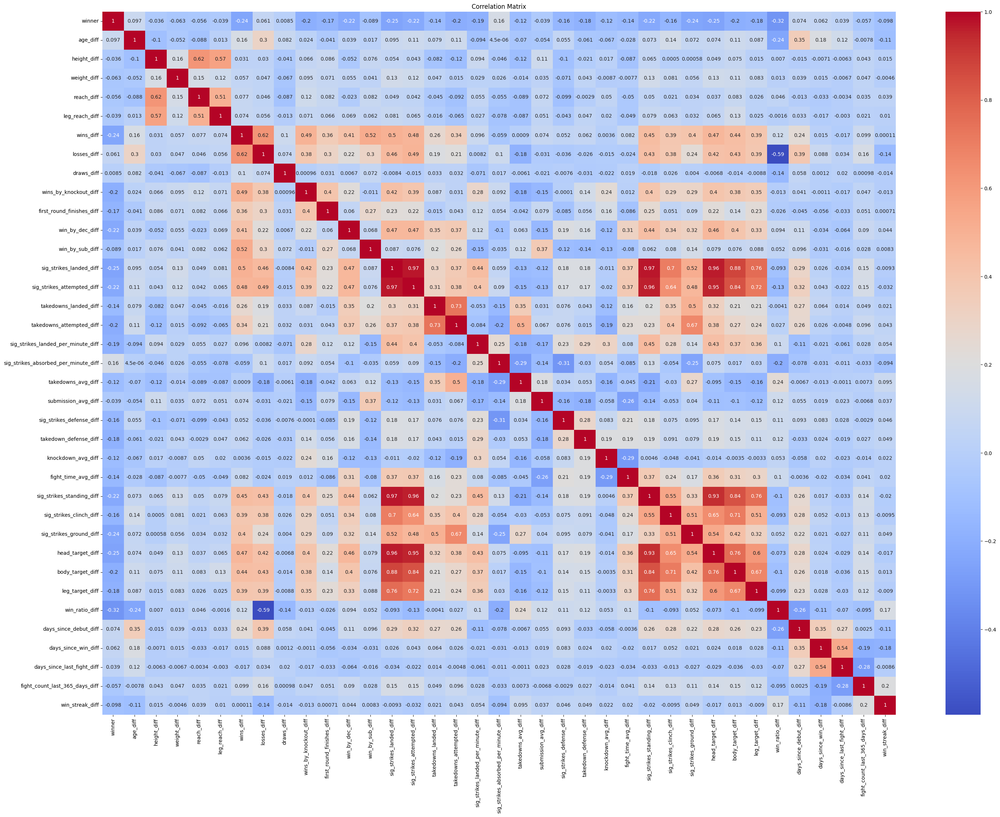

In [23]:
plt.figure(figsize=(35,25))
sns.heatmap(df_merged.corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [21]:
df_merged.to_csv('../data/merged_diff_df.csv', index=False)

Feature Selection

In [22]:
df_merged_diff = pd.read_csv('../data/merged_diff_df.csv')

In [24]:
X = df_merged_diff.drop('winner', axis=1)
y = df_merged_diff['winner']

In [25]:
print(X.shape, '\n', X.columns)

(5833, 36) 
 Index(['age_diff', 'height_diff', 'weight_diff', 'reach_diff',
       'leg_reach_diff', 'wins_diff', 'losses_diff', 'draws_diff',
       'wins_by_knockout_diff', 'first_round_finishes_diff', 'win_by_dec_diff',
       'win_by_sub_diff', 'sig_strikes_landed_diff',
       'sig_strikes_attempted_diff', 'takedowns_landed_diff',
       'takedowns_attempted_diff', 'sig_strikes_landed_per_minute_diff',
       'sig_strikes_absorbed_per_minute_diff', 'takedowns_avg_diff',
       'submission_avg_diff', 'sig_strikes_defense_diff',
       'takedown_defense_diff', 'knockdown_avg_diff', 'fight_time_avg_diff',
       'sig_strikes_standing_diff', 'sig_strikes_clinch_diff',
       'sig_strikes_ground_diff', 'head_target_diff', 'body_target_diff',
       'leg_target_diff', 'win_ratio_diff', 'days_since_debut_diff',
       'days_since_win_diff', 'days_since_last_fight_diff',
       'fight_count_last_365_days_diff', 'win_streak_diff'],
      dtype='object')


Variance Threshold

In [26]:
vt = VarianceThreshold(threshold=0.05)
vt.fit_transform(X)
vt_selected = X.columns[vt.get_support()]
vt_dropped = set(X.columns) - set(vt_selected)

print('Columns selected: ', vt_selected, '\n\n', len(vt_selected), 
    '\n\n', 'Columns dropped: ', vt_dropped, '\n\n', len(vt_dropped))

X = X[vt_selected]

Columns selected:  Index(['age_diff', 'height_diff', 'weight_diff', 'reach_diff',
       'leg_reach_diff', 'wins_diff', 'losses_diff', 'draws_diff',
       'wins_by_knockout_diff', 'first_round_finishes_diff', 'win_by_dec_diff',
       'win_by_sub_diff', 'sig_strikes_landed_diff',
       'sig_strikes_attempted_diff', 'takedowns_landed_diff',
       'takedowns_attempted_diff', 'sig_strikes_landed_per_minute_diff',
       'sig_strikes_absorbed_per_minute_diff', 'takedowns_avg_diff',
       'submission_avg_diff', 'sig_strikes_defense_diff',
       'takedown_defense_diff', 'knockdown_avg_diff', 'fight_time_avg_diff',
       'sig_strikes_standing_diff', 'sig_strikes_clinch_diff',
       'sig_strikes_ground_diff', 'head_target_diff', 'body_target_diff',
       'leg_target_diff', 'days_since_debut_diff', 'days_since_win_diff',
       'days_since_last_fight_diff', 'fight_count_last_365_days_diff',
       'win_streak_diff'],
      dtype='object') 

 35 

 Columns dropped:  {'win_ratio_diff'} 



Recursive Feature Elimination (RFECV)

In [27]:
model = RandomForestClassifier(random_state=42)
cv = StratifiedKFold(5)

rfecv = RFECV(estimator=model, step=1, cv=cv, scoring='accuracy')
rfecv.fit(X, y)

rfe_selected = X.columns[rfecv.support_]
rfe_dropped = set(X.columns) - set(rfe_selected)

print('Columns selected: ', rfe_selected, '\n\n', len(rfe_selected), 
    '\n\n', 'Columns dropped: ', rfe_dropped, '\n\n', len(rfe_dropped))

X = X[rfe_selected]

Columns selected:  Index(['wins_diff', 'losses_diff', 'win_by_dec_diff',
       'sig_strikes_landed_diff', 'sig_strikes_attempted_diff',
       'takedowns_attempted_diff', 'takedowns_avg_diff', 'submission_avg_diff',
       'sig_strikes_defense_diff', 'takedown_defense_diff',
       'knockdown_avg_diff', 'fight_time_avg_diff',
       'sig_strikes_standing_diff', 'sig_strikes_clinch_diff',
       'sig_strikes_ground_diff', 'head_target_diff', 'body_target_diff',
       'leg_target_diff', 'days_since_debut_diff', 'days_since_win_diff',
       'days_since_last_fight_diff'],
      dtype='object') 

 21 

 Columns dropped:  {'first_round_finishes_diff', 'sig_strikes_landed_per_minute_diff', 'draws_diff', 'win_by_sub_diff', 'leg_reach_diff', 'win_streak_diff', 'reach_diff', 'weight_diff', 'fight_count_last_365_days_diff', 'takedowns_landed_diff', 'wins_by_knockout_diff', 'sig_strikes_absorbed_per_minute_diff', 'age_diff', 'height_diff'} 

 14


Feature Importance Pruning

In [28]:
model.fit(X,y)
importances = pd.Series(model.feature_importances_, index=X.columns)

top_features = importances.sort_values(ascending=False).head(15).index
top_features

importance_dropped = set(X.columns) - set(top_features)

print('Columns selected: ', top_features, '\n\n', len(top_features), 
    '\n\n', 'Columns dropped: ', importance_dropped, '\n\n', len(importance_dropped))

X = X[top_features]

Columns selected:  Index(['days_since_debut_diff', 'losses_diff', 'wins_diff', 'head_target_diff',
       'sig_strikes_ground_diff', 'sig_strikes_landed_diff',
       'knockdown_avg_diff', 'takedowns_avg_diff', 'sig_strikes_standing_diff',
       'sig_strikes_attempted_diff', 'takedowns_attempted_diff',
       'takedown_defense_diff', 'submission_avg_diff', 'days_since_win_diff',
       'leg_target_diff'],
      dtype='object') 

 15 

 Columns dropped:  {'body_target_diff', 'fight_time_avg_diff', 'days_since_last_fight_diff', 'sig_strikes_clinch_diff', 'sig_strikes_defense_diff', 'win_by_dec_diff'} 

 6


In [29]:
X.shape

(5833, 15)

Concatenate and Save

In [30]:
df_final = pd.concat([X.reset_index(drop=True), y.reset_index(drop=True)], axis=1)
df_final.to_csv('../data/features_selected.csv', index=False)